# 02 - Limpieza y Análisis Exploratorio
Este notebook realiza la limpieza y transformación de datos.

In [1]:

# Importar librerías
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Cargar datos desde la carpeta data/raw
data_path = '../data/raw/Housing.csv'
housing_df = pd.read_csv(data_path)

### DESCRIPCION
- id: Identificador único de la propiedad.
- date: Fecha de listado de la propiedad.
- price: Precio de la propiedad (variable objetivo).
- bedrooms: Número de habitaciones.
- bathrooms: Número de baños.
- sqft_living: Área habitable en pies cuadrados.
- sqft_lot: Tamaño total del lote en pies cuadrados.
- floors: Número de pisos.
- waterfront: Vista al agua (1 = sí, 0 = no).
- view: Calidad de la vista (0 a 4).
- condition: Estado general de la propiedad (1 a 5).
- grade: Calidad de construcción y diseño (1 a 13).
- sqft_above: Área sobre el nivel del suelo en pies cuadrados.
- sqft_basement: Área del sótano en pies cuadrados.
- yr_built: Año de construcción.
- yr_renovated: Año de la última renovación.
- zipcode: Código postal de la ubicación.
- lat: Coordenadas geográficas de latitud de la propiedad.
- long: Coordenadas geográficas de longitud la propiedad.
- sqft_living15: Promedio del área habitable de las 15 propiedades más cercanas.
- sqft_lot15: Promedio del tamaño del lote de las 15 propiedades más cercanas

### Combrobamos que no hay missing values, variables preditoras y sus types

In [2]:
# Info
housing_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21613 non-null  int64  
 1   date           21613 non-null  object 
 2   price          21613 non-null  float64
 3   bedrooms       21613 non-null  int64  
 4   bathrooms      21613 non-null  float64
 5   sqft_living    21613 non-null  int64  
 6   sqft_lot       21613 non-null  int64  
 7   floors         21613 non-null  float64
 8   waterfront     21613 non-null  int64  
 9   view           21613 non-null  int64  
 10  condition      21613 non-null  int64  
 11  grade          21613 non-null  int64  
 12  sqft_above     21613 non-null  int64  
 13  sqft_basement  21613 non-null  int64  
 14  yr_built       21613 non-null  int64  
 15  yr_renovated   21613 non-null  int64  
 16  zipcode        21613 non-null  int64  
 17  lat            21613 non-null  float64
 18  long  

### Vemos la distribucion de Price y sus correlaciones

In [3]:
# Calcular la matrix correlacion sin'date'
correlation_matrix_1 = housing_df.drop(columns=['date']).corr(numeric_only=True)

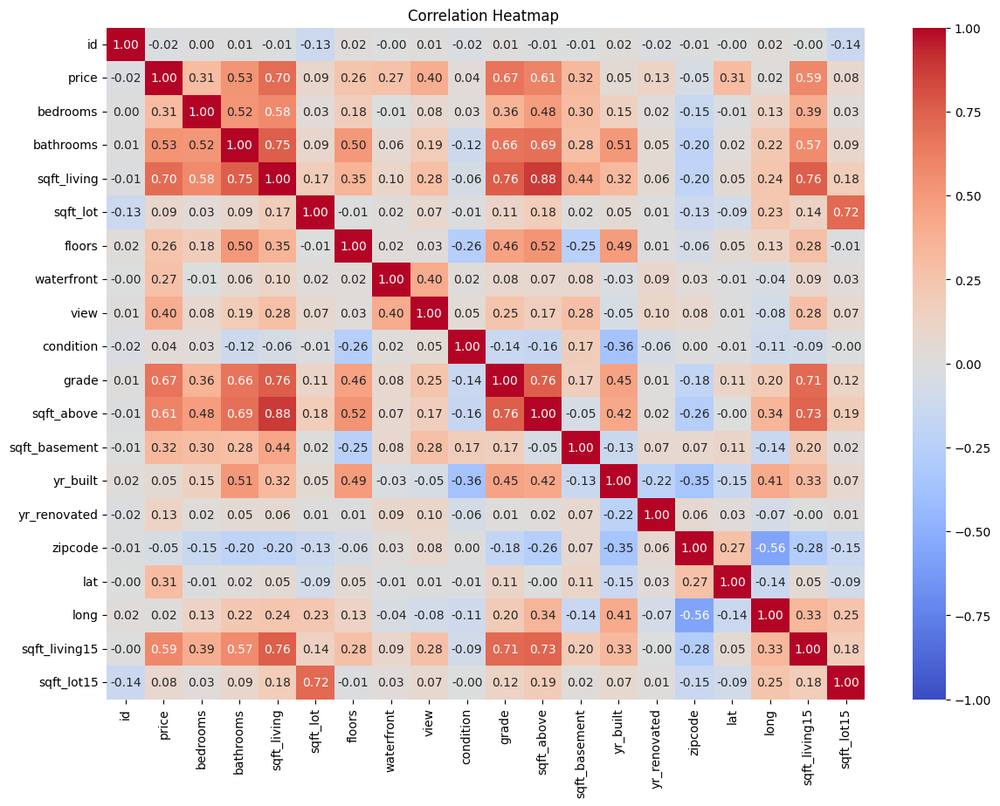

In [4]:
# Display the correlation heatmap
plt.figure(figsize=(14, 10))
sns.heatmap(correlation_matrix_1, annot=True, fmt=".2f", cmap="coolwarm", vmin=-1, vmax=1)
plt.title("Correlation Heatmap ")
plt.show()

### Vemos la distribucion de nuestro target "Price"


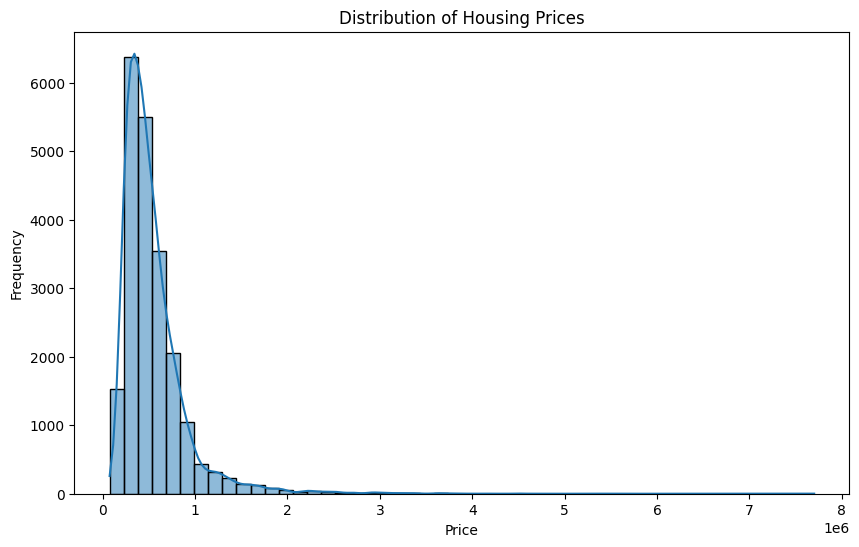

In [5]:
# Plot the distribution of the 'price' variable
plt.figure(figsize=(10, 6))
sns.histplot(housing_df['price'], bins=50, kde=True)
plt.title("Distribution of Housing Prices")
plt.xlabel("Price")
plt.ylabel("Frequency")
plt.show()

### Combrobamos la fecha de entrada de datos sobre viviendas en venta

In [6]:
 # Convertir la columna 'date' a den formato datetime
housing_df['date'] = pd.to_datetime(housing_df['date'], errors='coerce')
housing_df['date'].sort_values()

16768   2014-05-02
9596    2014-05-02
9587    2014-05-02
20602   2014-05-02
11577   2014-05-02
           ...    
7898    2015-05-14
928     2015-05-14
5637    2015-05-15
13053   2015-05-24
16594   2015-05-27
Name: date, Length: 21613, dtype: datetime64[ns]

### Combrobamos dondes estan localizadas las viviendas

In [7]:
from folium.plugins import MarkerCluster
import folium
mean_lat =housing_df["lat"].mean()
mean_long =housing_df["long"].mean()
# Crear el mapa
map_housing = folium.Map(location=[mean_lat, mean_long], zoom_start=10)

# Crear un clúster de marcadores
marker_cluster = MarkerCluster().add_to(map_housing)

# Añadir marcadores al clúster
for _, row in housing_df.iterrows():
    folium.Marker(location=[row['lat'], row['long']], 
                  popup=f"Price: {row['price']}").add_to(marker_cluster)

map_housing

In [8]:
import os
# Guardar el mapa en un archivo HTML en otra carpeta
output_dir = '../docs/folium_maps'
os.makedirs(output_dir, exist_ok=True)
output_path = os.path.join(output_dir, 'housing_map.html')
map_housing.save(output_path)

output_path

'../docs/folium_maps\\housing_map.html'

# Featurew Engeneering Inicial

### Combrobamos grade y condition con el Tarjet

In [9]:
# Crear los rangos de precios en grade y condition
housing_df['price_grade'] = pd.qcut(housing_df['price'], q=13, labels=range(1, 14))
housing_df['price_condition'] = pd.qcut(housing_df['price'], q=5, labels=range(1, 6))
# Verificar los resultados
print(housing_df[['price', 'price_grade']].head())
# Contar cuántos valores hay en cada rango de 'grade'
print(housing_df['grade'].value_counts().sort_index())

      price price_grade
0  231300.0           2
1  538000.0           9
2  180000.0           1
3  604000.0          10
4  510000.0           8
grade
1        1
3        3
4       29
5      242
6     2038
7     8981
8     6068
9     2615
10    1134
11     399
12      90
13      13
Name: count, dtype: int64


In [10]:
# Calcular el promedio de precio por grado y condicion
price_trend = housing_df.groupby('price_grade')['price'].mean().reset_index()
price_trend1 = housing_df.groupby('price_condition')['price'].mean().reset_index()
price_trend,price_trend1


C:\Users\Pablo\AppData\Local\Temp\ipykernel_1436\1683716362.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  price_trend = housing_df.groupby('price_grade')['price'].mean().reset_index()
C:\Users\Pablo\AppData\Local\Temp\ipykernel_1436\1683716362.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  price_trend1 = housing_df.groupby('price_condition')['price'].mean().reset_index()


(   price_grade         price
 0            1  1.927969e+05
 1            2  2.534910e+05
 2            3  2.928121e+05
 3            4  3.324765e+05
 4            5  3.713567e+05
 5            6  4.116492e+05
 6            7  4.529286e+05
 7            8  5.025504e+05
 8            9  5.562418e+05
 9           10  6.248051e+05
 10          11  7.168884e+05
 11          12  8.539486e+05
 12          13  1.470119e+06,
   price_condition         price
 0               1  2.371344e+05
 1               2  3.462219e+05
 2               3  4.539499e+05
 3               4  5.995290e+05
 4               5  1.063954e+06)

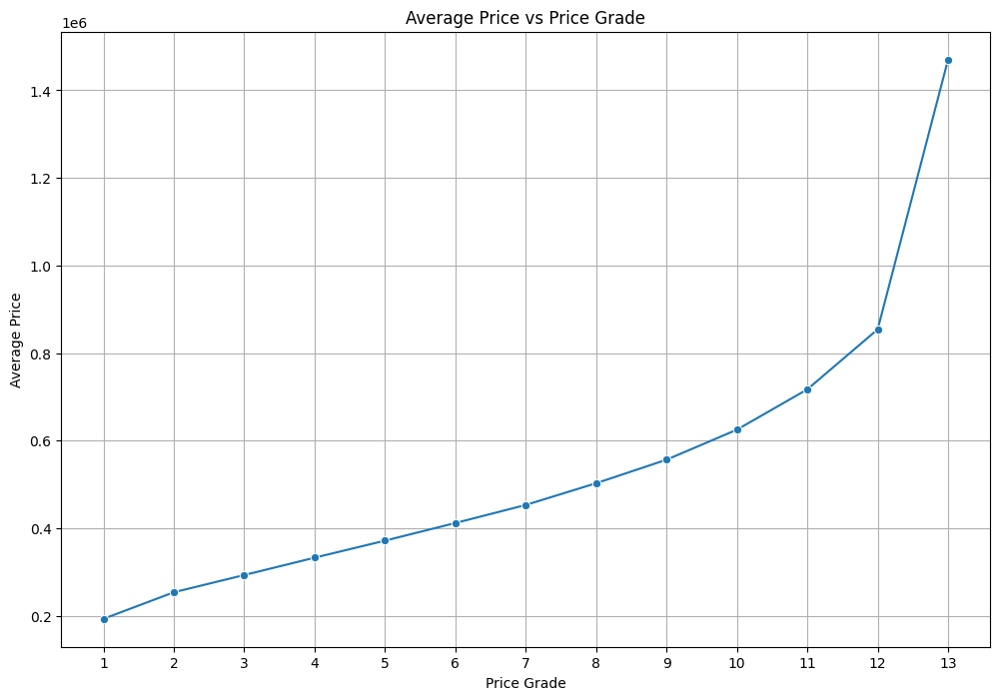

In [11]:
# Gráfico de línea para mostrar la tendencia
plt.figure(figsize=(12, 8))
sns.lineplot(data=price_trend, x='price_grade', y='price', marker='o')
plt.title("Average Price vs Price Grade")
plt.xlabel("Price Grade")
plt.ylabel("Average Price")
plt.xticks(range(1, 14))  # Asegurar que se muestren todos los grados
plt.grid(True)
plt.show()

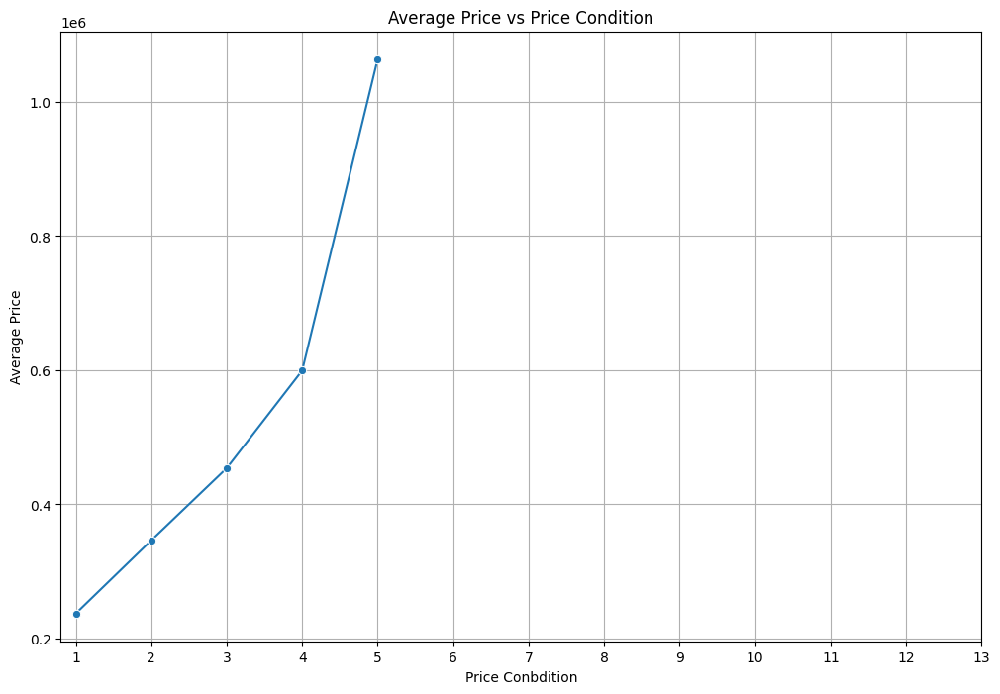

In [12]:
# Gráfico de línea para mostrar la tendencia
plt.figure(figsize=(12, 8))
sns.lineplot(data=price_trend1, x='price_condition', y='price', marker='o')
plt.title("Average Price vs Price Condition")
plt.xlabel("Price Conbdition")
plt.ylabel("Average Price")
plt.xticks(range(1, 14))  # Asegurar que se muestren todos los conditions
plt.grid(True)
plt.show()

### Intentamos entender valores agrupandolos por el zipcode y el tamaño medio por las viviendas proximas

In [13]:
# Agrupa por zipcode y calcula estadísticas de sqft_living15, sqft_lot15 y precio
zipcode_stats = housing_df.groupby('zipcode').agg({
   'sqft_living15': ['mean', 'min', 'max'],
    'sqft_lot15': ['mean', 'min', 'max'],
    'price': ['mean', 'max']
})

# Renombra las columnas para mayor claridad
zipcode_stats.columns = ['sqft_living15_mean', 'sqft_living15_min', 'sqft_living15_max',
                         'sqft_lot15_mean', 'sqft_lot15_min', 'sqft_lot15_max',
                         'price_mean', 'price_max']

# Resetea el índice para facilitar la manipulación
zipcode_stats.reset_index(inplace=True)
# Clasificar según rangos
zipcode_stats['sqft_living15_range'] = pd.cut(
    zipcode_stats['sqft_living15_mean'],
    bins=[0, 1500, 2500, 4000, float('inf')],
    labels=['Pequeño', 'Mediano', 'Grande', 'Muy grande']
)
#
zipcode_stats['sqft_lot15_range'] = pd.cut(
    zipcode_stats['sqft_lot15_mean'],
    bins=[0, 5000, 10000, 20000, float('inf')],
    labels=['Pequeño', 'Mediano', 'Grande', 'Muy grande'])
# Filtrar zipcodes con precios promedio altos
expensive_zipcodes = zipcode_stats[zipcode_stats['price_mean'] > zipcode_stats['price_mean'].quantile(0.9)]

# Ordenar por precios
expensive_zipcodes = expensive_zipcodes.sort_values(by='price_mean', ascending=False)

# Mostrar los zipcodes más caros y sus rangos
print(expensive_zipcodes[['zipcode', 'price_mean', 'sqft_living15_range', 'sqft_lot15_range']])


    zipcode    price_mean sqft_living15_range sqft_lot15_range
24    98039  2.160607e+06              Grande           Grande
3     98004  1.355927e+06              Grande           Grande
25    98040  1.194230e+06              Grande           Grande
48    98112  1.095499e+06             Mediano          Pequeño
41    98102  9.012583e+05             Mediano          Pequeño
47    98109  8.796236e+05             Mediano          Pequeño
43    98105  8.628252e+05             Mediano          Pequeño


### Creamos la variable precio por pie cuadrado y vemos que zipcode son de media mas caros

In [14]:
# Crear una nueva columna para el precio por pie cuadrado
housing_df['price_per_sqft'] = housing_df['price'] / housing_df['sqft_living']
# Calcular el precio promedio por pie cuadrado por zipcode
avg_price_per_sqft_per_zipcode = housing_df.groupby('zipcode')['price_per_sqft'].mean()

# Ordenar de mayor a menor
avg_price_per_sqft_per_zipcode_sorted = avg_price_per_sqft_per_zipcode.sort_values(ascending=False)

# Mostrar los resultados
print(avg_price_per_sqft_per_zipcode_sorted)

zipcode
98039    568.083350
98004    475.435611
98112    438.637872
98109    433.401195
98119    432.256998
            ...    
98030    155.156221
98032    154.219513
98001    151.387938
98002    151.174091
98023    148.919829
Name: price_per_sqft, Length: 70, dtype: float64


### Creamos variable distancia al Centro de Seattle

In [15]:
from geopy.distance import geodesic

# Agrupar zipcodes en rangos basados en precio
housing_df['zipcode_group'] = pd.qcut(housing_df['price'], q=5, labels=range(1, 6))

# Calcular distancia al centro de Seattle (coordenadas ejemplo)
city_center = (47.6062, -122.3321)
housing_df['distance_to_center'] = housing_df.apply(
    lambda row: geodesic((row['lat'], row['long']), city_center).miles, axis=1
)

### Transformamos log

In [16]:
# Transformar variables sesgadas
housing_df['log_price'] = np.log1p(housing_df['price'])
housing_df['log_sqft_living'] = np.log1p(housing_df['sqft_living'])
housing_df['log_sqft_lot'] = np.log1p(housing_df['sqft_lot'])

### Creamos la variable de la relacion de no habitable con la habitable

In [17]:
# Relación entre tamaño del lote y el área habitable
housing_df['lot_to_living_ratio'] = housing_df['sqft_lot'] / housing_df['sqft_living']

### Creamos la variable edad de la propiedad

In [18]:
# Edad de la propiedad
housing_df['property_age'] = 2015 - housing_df[['yr_built', 'yr_renovated']].max(axis=1)

### Creamos la variable de la relacion de area con areas cercanas

In [19]:
# Relación del tamaño con el promedio vecinal
housing_df['rel_sqft_living15'] = housing_df['sqft_living'] / housing_df['sqft_living15']
housing_df['rel_sqft_lot15'] = housing_df['sqft_lot'] / housing_df['sqft_lot15']

### Agrupar zipcodes con pocos datos en una categoría "Otros"

In [20]:
# Agrupar zipcodes con pocos datos en una categoría "Otros"
top_zipcodes = housing_df['zipcode'].value_counts().nlargest(10).index
housing_df['zipcode_grouped'] = housing_df['zipcode'].apply(
    lambda z: z if z in top_zipcodes else 'Other'
)

In [21]:
# Verificar el dataset final
housing_df_final = housing_df.copy()
housing_df_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 34 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   id                   21613 non-null  int64         
 1   date                 21613 non-null  datetime64[ns]
 2   price                21613 non-null  float64       
 3   bedrooms             21613 non-null  int64         
 4   bathrooms            21613 non-null  float64       
 5   sqft_living          21613 non-null  int64         
 6   sqft_lot             21613 non-null  int64         
 7   floors               21613 non-null  float64       
 8   waterfront           21613 non-null  int64         
 9   view                 21613 non-null  int64         
 10  condition            21613 non-null  int64         
 11  grade                21613 non-null  int64         
 12  sqft_above           21613 non-null  int64         
 13  sqft_basement        21613 non-

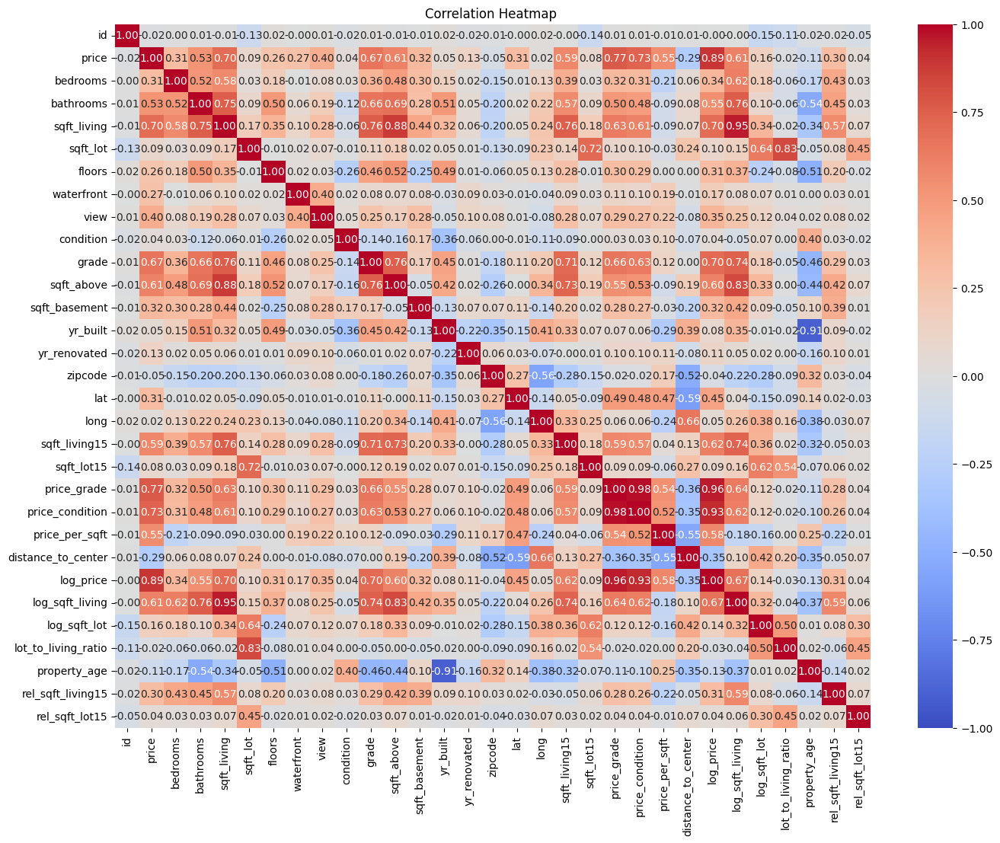

In [22]:

housing_df_final['date'] = pd.to_datetime(housing_df['date'], errors='coerce')
housing_df_final['price_grade'] = pd.to_numeric(housing_df['price_grade'], errors='coerce')
housing_df_final['price_condition'] = pd.to_numeric(housing_df['price_condition'], errors='coerce')

correlation_matrix= housing_df_final.drop(columns=['date']).corr(numeric_only=True)
#  heatmap
plt.figure(figsize=(16, 12))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap="coolwarm", vmin=-1, vmax=1)
plt.title("Correlation Heatmap ")
plt.show()

### Nos quedamos con las mas correlacionadas

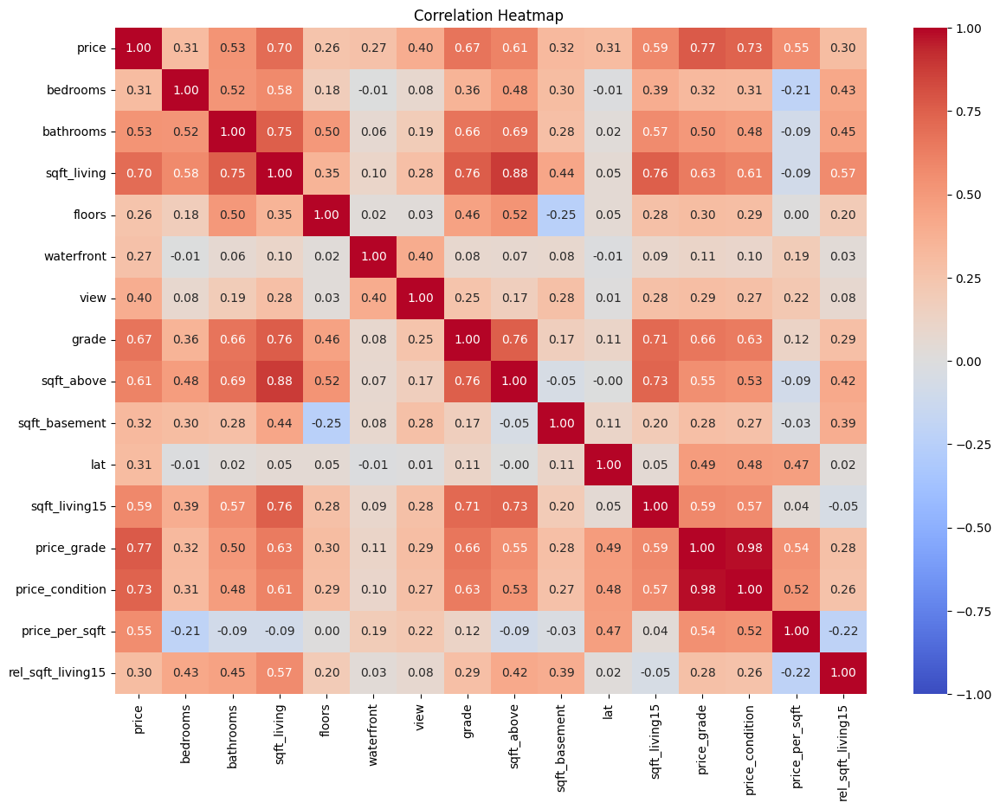

In [23]:
correlation_matrix_cleaned = housing_df_final.drop(columns=['date','id','zipcode_grouped','zipcode_group','sqft_lot','condition','rel_sqft_lot15','yr_built','yr_renovated','zipcode','long','sqft_lot15','distance_to_center','log_price','log_sqft_living','log_sqft_lot','lot_to_living_ratio','property_age']).corr(numeric_only=True)

#  heatmap
plt.figure(figsize=(14, 10))
sns.heatmap(correlation_matrix_cleaned, annot=True, fmt=".2f", cmap="coolwarm", vmin=-1, vmax=1)
plt.title("Correlation Heatmap ")
plt.show()

### Debido ha problemas que desconozco no pude seguir con este planteamiento y decidi darle otra perspectiva la cual ha sido la definitiva

# Feature Engeneering para el modelo final


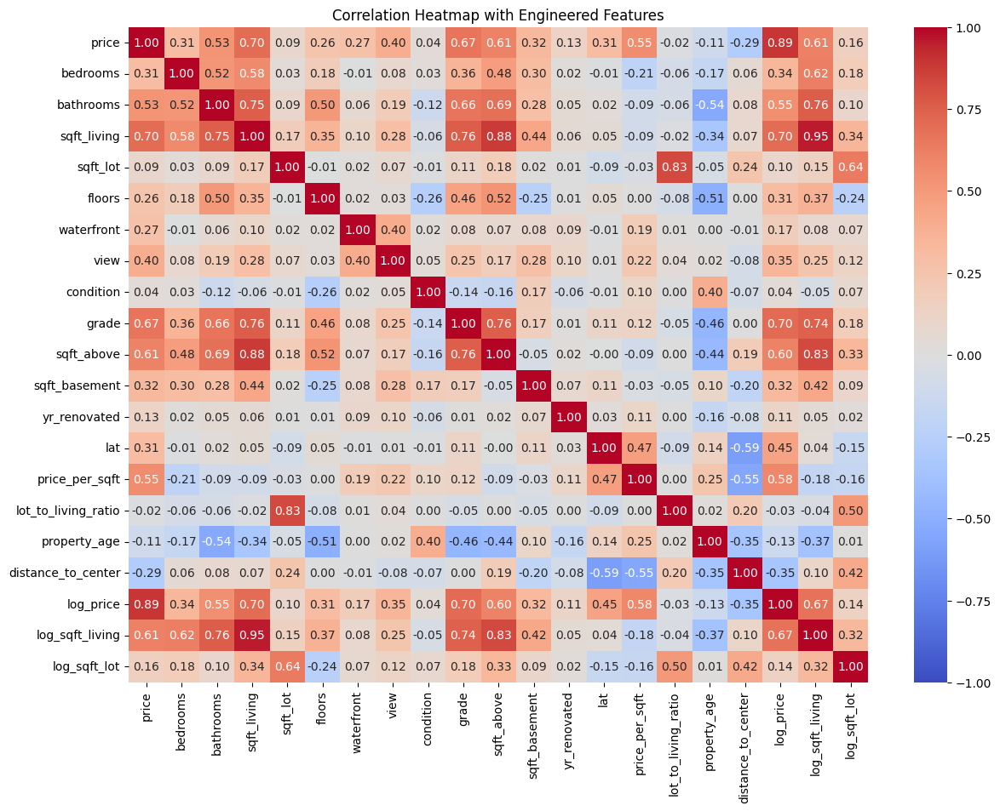

In [24]:
# Importar librerías
from geopy.distance import geodesic
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

data_path = '../data/raw/Housing.csv'
housing_df = pd.read_csv(data_path)

# 1. Crear las nuevas variables propuestas en Feature Engineering

# Precio por pie cuadrado
housing_df['price_per_sqft'] = housing_df['price'] / housing_df['sqft_living']

# Relación lote/habitable
housing_df['lot_to_living_ratio'] = housing_df['sqft_lot'] / housing_df['sqft_living']

# Edad de la propiedad
housing_df['property_age'] = 2015 - housing_df[['yr_built', 'yr_renovated']].max(axis=1)

# Distancia al centro de Seattle
city_center = (47.6062, -122.3321)
housing_df['distance_to_center'] = housing_df.apply(
    lambda row: geodesic((row['lat'], row['long']), city_center).miles, axis=1
)

# Transformaciones logarítmicas
housing_df['log_price'] = np.log1p(housing_df['price'])
housing_df['log_sqft_living'] = np.log1p(housing_df['sqft_living'])
housing_df['log_sqft_lot'] = np.log1p(housing_df['sqft_lot'])

# 2. Generar la matriz de correlación con las nuevas variables
columns_to_exclude = [
    'id', 'date', 'zipcode','long', 
    'yr_built', 'sqft_living15', 'sqft_lot15'
]

correlation_matrix2 = housing_df.drop(columns=columns_to_exclude).corr(numeric_only=True)

# 3. Visualizar la matriz de correlación con un heatmap

plt.figure(figsize=(14, 10))
sns.heatmap(correlation_matrix2, annot=True, fmt=".2f", cmap="coolwarm", vmin=-1, vmax=1)
plt.title("Correlation Heatmap with Engineered Features")
plt.show()


### Ver modelos con datos normales y escalados

In [25]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.preprocessing import StandardScaler

# Variables independientes iniciales (todas menos las irrelevantes o contaminadas)
selected_features = ['sqft_living', 'grade', 'bathrooms', 'distance_to_center', 'property_age', 'bedrooms','view','lat','floors','waterfront']

X_initial = housing_df[selected_features]

y_initial = housing_df['price']

# Dividir el dataset en entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X_initial, y_initial, test_size=0.2, random_state=42)


In [26]:
# Modelo de regresión lineal
model_initial = LinearRegression()
model_initial.fit(X_train, y_train)

# Predicciones
y_pred_initial = model_initial.predict(X_test)

# Evaluación del modelo inicial
rmse_initial = np.sqrt(mean_squared_error(y_test, y_pred_initial))
r2_initial = r2_score(y_test, y_pred_initial)
mae_initial = mean_absolute_error(y_test,y_pred_initial)
# Resultados iniciales
results_initial = {
    "RMSE": rmse_initial,
    "R2": r2_initial,
    "MAE": mae_initial}
results_initial



{'RMSE': np.float64(210800.17436069547),
 'R2': 0.706061119817188,
 'MAE': np.float64(127617.50510207743)}

In [27]:
# Seleccionar las variables más correlacionadas para el segundo modelo
selected_features = ['sqft_living', 'grade', 'bathrooms', 'distance_to_center', 'property_age', 'bedrooms','view','lat','floors','waterfront']

X_selected = housing_df[selected_features]
scaler = StandardScaler()
X_selected = scaler.fit_transform(X_selected)

# Dividir el dataset con las variables seleccionadas
X_train_sel, X_test_sel, y_train_sel, y_test_sel = train_test_split(X_selected, y_initial, test_size=0.2, random_state=42)

In [28]:
# Modelo de regresión lineal con variables seleccionadas
model_selected = LinearRegression()
model_selected.fit(X_train_sel, y_train_sel)

# Predicciones con variables seleccionadas
y_pred_selected = model_selected.predict(X_test_sel)

# Evaluación del modelo con variables seleccionadas
rmse_selected = np.sqrt(mean_squared_error(y_test_sel, y_pred_selected))
r2_selected = r2_score(y_test_sel, y_pred_selected)
mae_selected = mean_absolute_error(y_test_sel,y_pred_selected)
# Resultados con variables seleccionadas
results_selected = {
    "RMSE": rmse_selected,
    "R2": r2_selected,
    "MAE": mae_selected
}

# Mostrar ambos resultados
results_selected

{'RMSE': np.float64(210800.17436069532),
 'R2': 0.7060611198171884,
 'MAE': np.float64(127617.50510207967)}

In [29]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor

# Modelo Random Forest con todas las variables
rf_model_initial = RandomForestRegressor(random_state=42, n_estimators=100)
rf_model_initial.fit(X_train, y_train)
y_pred_rf_initial = rf_model_initial.predict(X_test)

# Evaluación Random Forest con todas las variables
rmse_rf_initial = np.sqrt(mean_squared_error(y_test, y_pred_rf_initial))
r2_rf_initial = r2_score(y_test, y_pred_rf_initial)
mae_rf_initial = mean_absolute_error(y_test,y_pred_rf_initial)
# Modelo Gradient Boosting con todas las variables
gb_model_initial = GradientBoostingRegressor(random_state=42, n_estimators=100)
gb_model_initial.fit(X_train, y_train)
y_pred_gb_initial = gb_model_initial.predict(X_test)

# Evaluación Gradient Boosting con todas las variables
rmse_gb_initial = np.sqrt(mean_squared_error(y_test, y_pred_gb_initial))
r2_gb_initial = r2_score(y_test, y_pred_gb_initial)
mae_gb_initial = mean_absolute_error(y_test,y_pred_gb_initial)



In [30]:
# Modelo Random Forest con variables escaladas
rf_model_selected = RandomForestRegressor(random_state=42, n_estimators=100)
rf_model_selected.fit(X_train_sel, y_train_sel)
y_pred_rf_selected = rf_model_selected.predict(X_test_sel)

# Evaluación Random Forest con variables escaladas
rmse_rf_selected = np.sqrt(mean_squared_error(y_test_sel, y_pred_rf_selected))
r2_rf_selected = r2_score(y_test_sel, y_pred_rf_selected)
mae_rf_selected = mean_absolute_error(y_test_sel,y_pred_rf_selected)
# Modelo Gradient Boosting con variables escaladas
gb_model_selected = GradientBoostingRegressor(random_state=42, n_estimators=100)
gb_model_selected.fit(X_train_sel, y_train_sel)
y_pred_gb_selected = gb_model_selected.predict(X_test_sel)

# Evaluación Gradient Boosting con variables escaladas
rmse_gb_selected = np.sqrt(mean_squared_error(y_test_sel, y_pred_gb_selected))
r2_gb_selected = r2_score(y_test_sel, y_pred_gb_selected)
mae_gb_selected = mean_absolute_error(y_test_sel,y_pred_gb_selected)


In [31]:
# Resultados finales
results = {
    "Linear Regression (All Variables)": {"RMSE": rmse_initial, "R2": r2_initial, "MAE": mae_initial},
    "Linear Regression (Selected Variables)": {"RMSE": rmse_selected, "R2": r2_selected, "MAE": mae_selected},
    "Random Forest (All Variables)": {"RMSE": rmse_rf_initial, "R2": r2_rf_initial, "MAE": mae_rf_initial},
    "Random Forest (Selected Variables)": {"RMSE": rmse_rf_selected, "R2": r2_rf_selected, "MAE": mae_rf_selected},
    "Gradient Boosting (All Variables)": {"RMSE": rmse_gb_initial, "R2": r2_gb_initial, "MAE": mae_gb_initial},
    "Gradient Boosting (Selected Variables)": {"RMSE": rmse_gb_selected, "R2": r2_gb_selected, "MAE": mae_gb_selected},
}

# Convertir resultados a un DataFrame
results_df = pd.DataFrame(results).T

# Mostrar el DataFrame
print(results_df)

                                                 RMSE        R2            MAE
Linear Regression (All Variables)       210800.174361  0.706061  127617.505102
Linear Regression (Selected Variables)  210800.174361  0.706061  127617.505102
Random Forest (All Variables)           134946.457584  0.879541   75844.291099
Random Forest (Selected Variables)      134830.039145  0.879749   75793.127229
Gradient Boosting (All Variables)       143310.702115  0.864146   84672.712661
Gradient Boosting (Selected Variables)  143310.702115  0.864146   84672.712661


In [32]:
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.ensemble import GradientBoostingRegressor
# Define the parameter grid for Gradient Boosting
param_grid = {
    'n_estimators': [50, 100, 150],
    'max_depth': [3, 5, 7],
    'learning_rate': [0.1, 0.2, 0.3],
}

# Configure GridSearchCV with Gradient Boosting
gb_model = GradientBoostingRegressor(random_state=42)
grid_search = GridSearchCV(estimator=gb_model, param_grid=param_grid, cv=5, scoring='neg_mean_squared_error', verbose=2, n_jobs=-1)

# Fit the model
grid_search.fit(X_train_sel, y_train_sel)

# Retrieve best parameters and the associated RMSE
best_params = grid_search.best_params_
best_model = grid_search.best_estimator_
best_rmse = np.sqrt(-grid_search.best_score_)

best_params, best_rmse

Fitting 5 folds for each of 27 candidates, totalling 135 fits


({'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 150},
 np.float64(127052.06567012379))

In [33]:
# Train the final Gradient Boosting model with optimal parameters
final_model = GradientBoostingRegressor(
    learning_rate=0.1,
    max_depth=5,
    n_estimators=150,
    random_state=42
)

# Fit the model on the training data
final_model.fit(X_train, y_train)

# Predict on the test set
y_pred_final = final_model.predict(X_test)

# Evaluate the final model
final_rmse = np.sqrt(mean_squared_error(y_test, y_pred_final))
final_r2 = r2_score(y_test, y_pred_final)
final_mae = mean_absolute_error(y_test, y_pred_final)
final_results = {
    "Final RMSE": final_rmse,
    "Final R²": final_r2,
    "Final MAE": final_mae
}

final_results


{'Final RMSE': np.float64(130506.17374717387),
 'Final R²': 0.8873380619814673,
 'Final MAE': np.float64(76115.03138696155)}

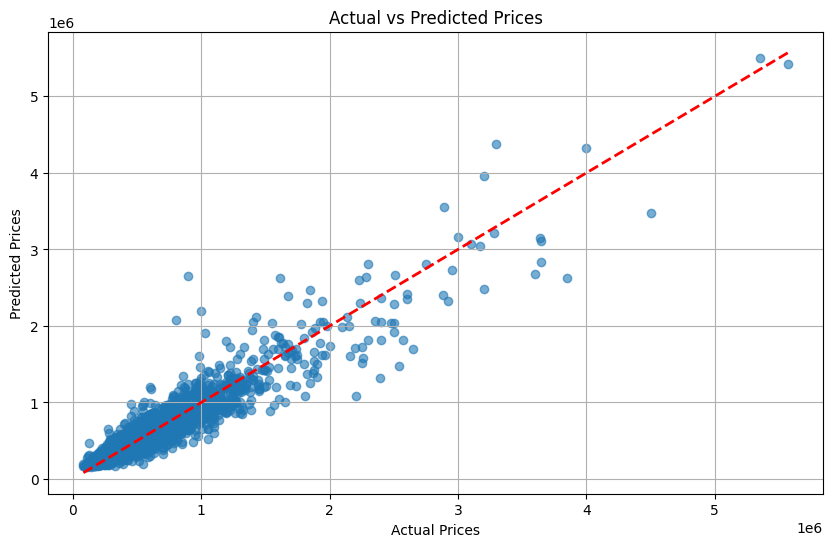

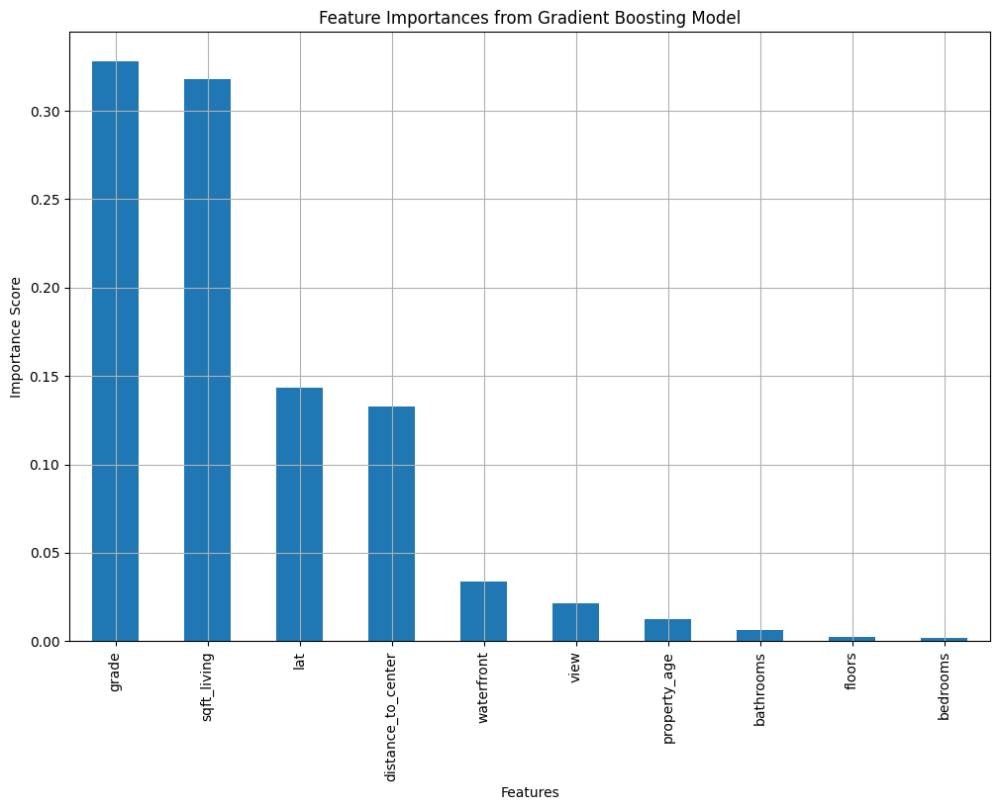

In [34]:
import matplotlib.pyplot as plt

# Plot actual vs predicted prices
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred_final, alpha=0.6)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], color='red', linestyle='--', linewidth=2)
plt.title('Actual vs Predicted Prices')
plt.xlabel('Actual Prices')
plt.ylabel('Predicted Prices')
plt.grid()
plt.show()

# Feature importance visualization
feature_importances = pd.Series(final_model.feature_importances_, index=X_train.columns)
sorted_importances = feature_importances.sort_values(ascending=False)

# Plot feature importances
plt.figure(figsize=(12, 8))
sorted_importances.plot(kind='bar')
plt.title('Feature Importances from Gradient Boosting Model')
plt.ylabel('Importance Score')
plt.xlabel('Features')
plt.grid()
plt.show()


In [35]:
sorted_importances

grade                 0.328279
sqft_living           0.317928
lat                   0.143273
distance_to_center    0.132771
waterfront            0.033546
view                  0.021294
property_age          0.012549
bathrooms             0.006029
floors                0.002376
bedrooms              0.001955
dtype: float64